In [1]:
import numpy as np
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
import seaborn as sns
import datetime
from fuzzywuzzy import fuzz
from fuzzywuzzy import process
from scipy.stats import ttest_1samp, kendalltau, ttest_ind, ranksums
from sklearn.neighbors import NearestNeighbors
import os

In [2]:
# Read in municipality shapefiles
mun = gpd.read_file('/Users/lorenzoflores/Desktop/Yale_Academic/Stat Projects/MuniCities_Shapefiles/MuniCities.shp')
mun = gpd.GeoDataFrame(mun, geometry=mun['geometry'])


In [5]:
df = pd.read_csv('raw/Violence_Terrorism.csv')
df.columns = ['country','code','year','value']

df_count = pd.read_csv('raw/Violence_Terrorism_Count.csv')
df_count.columns = ['country','code','year','value']

In [6]:
df_ph = df.loc[df.country=='Philippines']
df_ph

,country,code,year,value
4508,Philippines,PHL,1990,2.848410
4509,Philippines,PHL,1991,3.052189
4510,Philippines,PHL,1992,1.263228
4511,Philippines,PHL,1993,0.403791
4512,Philippines,PHL,1994,0.612357
4513,Philippines,PHL,1995,0.545052
4514,Philippines,PHL,1996,0.402648
4515,Philippines,PHL,1997,0.562402
4516,Philippines,PHL,1998,0.149287
4517,Philippines,PHL,1999,0.330458


#### Insight
* The number of casualties per 100000 due to conflict and terrorism was <b>initially on a downtrend, but increased again towards 2013 onwards</b>

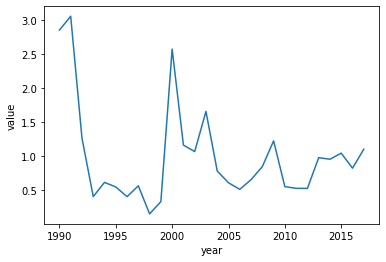

In [7]:
sns.lineplot(df[df.country=='Philippines']['year'],
             df[df.country=='Philippines']['value'])

#### Insight
* Rates of conflict and deaths per 100,000s have <b>gone down, but not with a significant trend throughout the years</b>

In [8]:
t, p = kendalltau(df_ph['year'],df_ph['value'])
print(f"Conflict/Terrorism Deaths per 100000 Trend\n Slope: {t}, p-val: {p}")


Conflict/Terrorism Deaths per 100000 Trend
 Slope: -0.010582010582010581, p-val: 0.9531919097653253


In [9]:
import numpy as np
from sklearn.linear_model import LinearRegression
model = LinearRegression().fit(df_ph[['year']],df_ph['value'])
model.score(df_ph[['year']],df_ph['value'])


0.07852030317509384

In [10]:
model.coef_

array([-0.02486914])

#### Insight
* The Philippines used to have one of the lowest rates of conflict in the 1990s – especially in comparison to Cambodia. Yet in recent years, <b>we have taken the lead amongst SEA neighbor countries</b>

In [11]:
sea = ['Viet Nam','Malaysia','Indonesia','Thailand','Cambodia','Philippines']

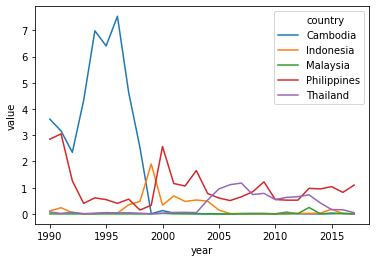

In [12]:
sns.lineplot(df.loc[df.country.isin(sea)]['year'],
             df.loc[df.country.isin(sea)]['value'],
             hue=df.loc[df.country.isin(sea)]['country'])

In [13]:
pd.pivot_table(df.loc[df.country.isin(sea)][['year','value','country']],
               index='year',
               values='value',
               columns='country').to_csv('fig_A.csv')

#### Insight
* In fact, the Philippines is <b>most similar to countries like Ukraine, Nigeria, Kenya, Turkey, Samoa</b> in terms of deaths by terrorism per 100,000s rate 

In [14]:
df_ave = df.loc[df.year>1999].groupby('country').agg({'value':np.mean})
df_ave = df_ave.reset_index()

In [15]:
df_ave = df_ave.sort_values(by='value').reset_index(drop=True)

In [16]:
df_ave.to_csv('fig_B.csv')

#### Insights
* PCA shows no distinct clusters – there are no particular years that stand out as particularly eventful – in other words <b> countries with high terrorism rates will be clustered with other high terrorism rates, regardless of the year</b>

In [17]:
df = pd.pivot_table(df,
               index='country',
               columns='year',
              values='value')

(-50, 150)

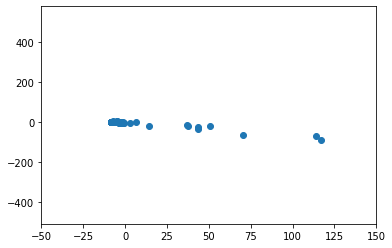

In [18]:
from sklearn.decomposition import PCA

df_sub = df.iloc[:,10:]
avg = df_sub.mean(0)
cmatrix = np.subtract(df_sub, avg)

pca = PCA()
pca.fit(cmatrix)
pcs = pca.fit_transform(cmatrix)

principal_vectors = pca.components_
pv1 = principal_vectors[0]
pv2 = principal_vectors[1]

pcs = pca.fit_transform(cmatrix)
plt.scatter(pcs[:,0],pcs[:,1])
plt.xlim(-50,150)

#### Insights
* The Philippines' average number of battles per year went up after 2000, <b>unlike most other countries in Southeast Asia which were on a decline</b>
* We are significantly further away from our neighbors

In [19]:
remove_countries = ['Andean Latin America','Central Asia',
 'Central Europe',
 'Central Europe, Eastern Europe, and Central Asia',
 'Central Latin America',
 'Central Sub-Saharan Africa',
    'Eastern Sub-Saharan Africa',
'High SDI',
 'High-income',
 'High-income Asia Pacific',
 'High-middle SDI','Latin America and Caribbean',
    'Low SDI',
 'Low-middle SDI','Middle SDI', 'Southeast Asia, East Asia, and Oceania',
 'Southern Latin America',
 'Southern Sub-Saharan Africa',
 'Tropical Latin America',
'Western Europe',
 'Western Sub-Saharan Africa',
 'World']



In [20]:
df_count = pd.pivot_table(df_count,
               index='country',
               columns='year',
              values='value')

[(0, 2000)]

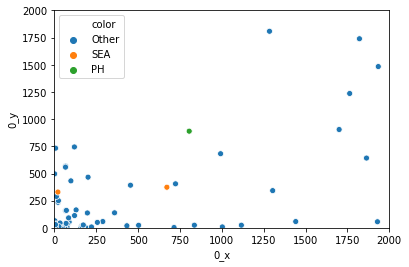

In [21]:
df_count = df_count.loc[~df_count.index.isin(remove_countries)]
df_count.columns = [str(i) for i in df_count.columns]

df_comp = pd.merge(pd.DataFrame(df_count.loc[:,:'2000'].mean(axis=1)),
         pd.DataFrame(df_count.loc[:,'2000':'2017'].mean(axis=1)),
        on='country').reset_index()

# Color the points
df_comp.loc[df_comp.country.isin(sea), 'color'] = 'SEA'
df_comp.loc[df_comp.country=='Philippines', 'color'] = 'PH'
df_comp.loc[df_comp.color.isnull(), 'color'] = 'Other'

# Plot 
a_plot = sns.scatterplot(df_comp['0_x'],
                df_comp['0_y'],
                hue=df_comp['color'])
a_plot.set(xlim=(0, 2000))
a_plot.set(ylim=(0, 2000))

In [28]:
df_comp.to_csv('fig_C.csv')

### Conflicts

In [22]:
df = pd.read_csv('raw/Violence_Conflict_Linelist.csv')
df = df.drop(0)
df['date'] = [i[:7] for i in df.event_date]
df['date'] =  pd.to_datetime(df.date, format='%Y-%m')


In [23]:
df.event_type.value_counts()

Violence against civilians    6460
Battles                       2178
Protests                      1146
Strategic developments         503
Explosions/Remote violence     377
Riots                           52
Name: event_type, dtype: int64

<b> Insight </b>
* Metro Manila has a high level of violence against civilians, <b>especially around the May 2016 election</b>
* Metro Manila also has a high level of riots/protests 
* Battles and <b> explosions are more prevalent in Maguindanao</b>

In [25]:
plt.rcParams['figure.dpi'] = 1000
def plot_violence(types, places, ret=False):
    df_counts = df.loc[df.event_type.isin(types)]
    df_counts = pd.DataFrame(df_counts.groupby(['date','admin2']).count()['iso']).reset_index()
    df_counts_sub = df_counts.loc[df_counts.admin2.isin(places)]
    if ret:
        return(df_counts)
    else:
        sns.lineplot(df_counts_sub['date'],
                df_counts_sub['iso'],
                hue=df_counts_sub['admin2'])

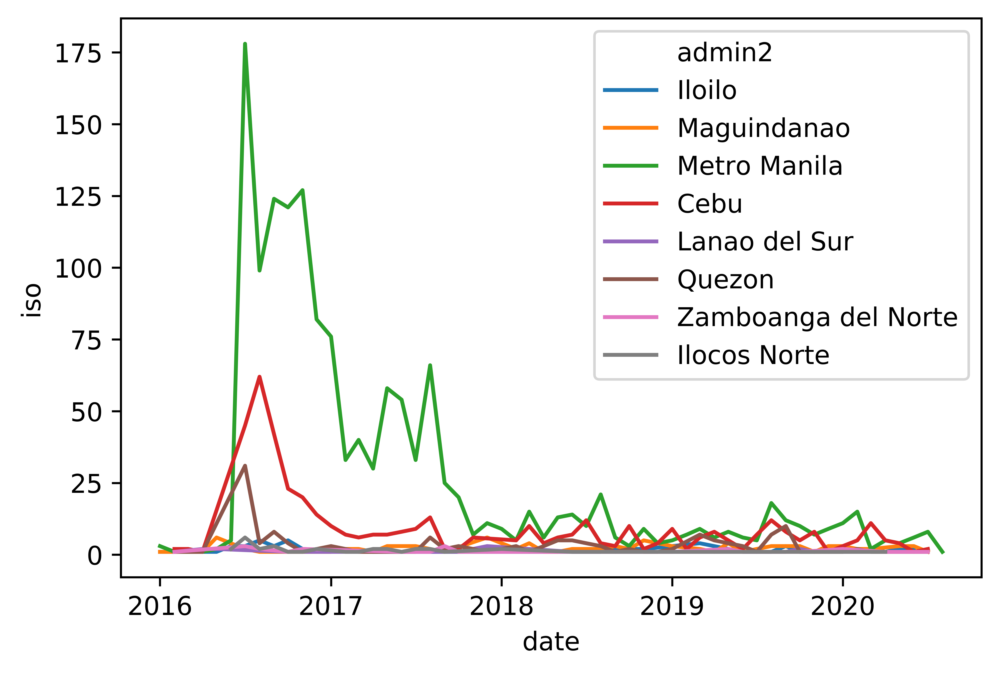

In [26]:
plot_violence(['Violence against civilians'],
              ['Ilocos Norte','Metro Manila','Quezon',
               'Iloilo','Cebu','Zamboanga del Norte',
               'Lanao del Sur','Maguindanao'])




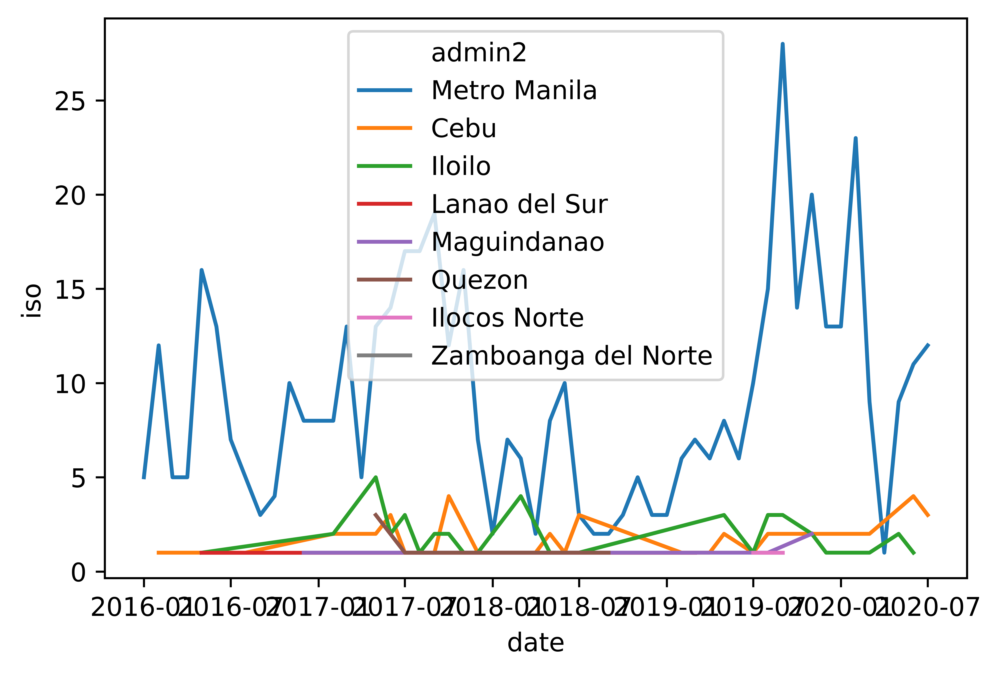

In [27]:
plot_violence(['Riots','Protests'],
              ['Ilocos Norte','Metro Manila','Quezon',
               'Iloilo','Cebu','Zamboanga del Norte',
               'Lanao del Sur','Maguindanao'])

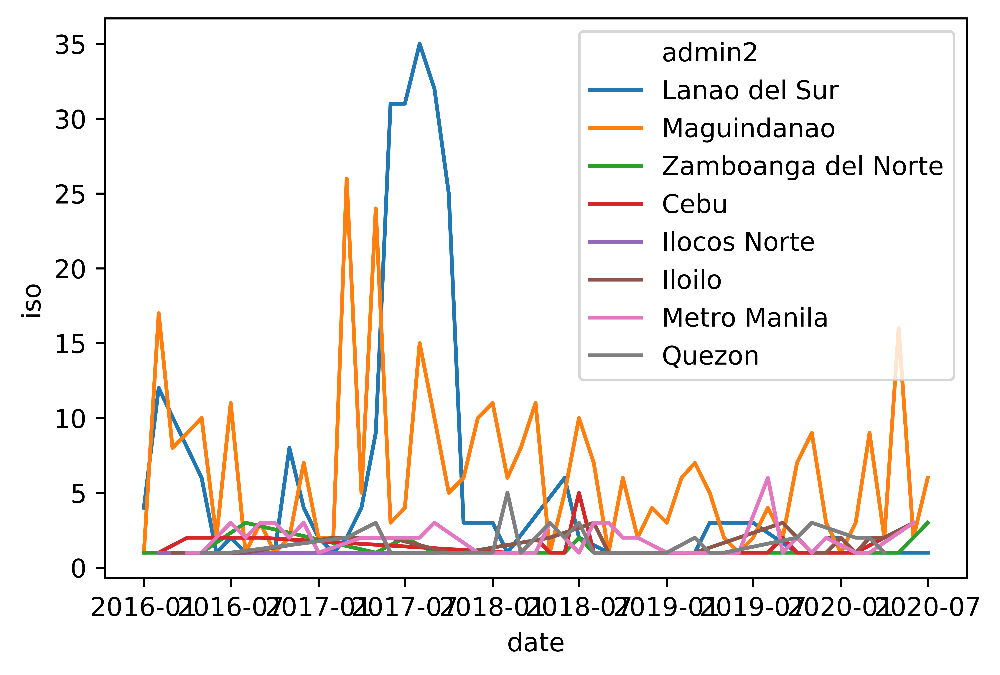

In [28]:
plot_violence(['Battles','Explosions/Remote violence'],
              ['Ilocos Norte','Metro Manila','Quezon',
               'Iloilo','Cebu','Zamboanga del Norte',
               'Lanao del Sur','Maguindanao'])

In [29]:
pd.pivot_table(plot_violence(['Battles','Explosions/Remote violence'],
              ['Ilocos Norte','Metro Manila','Quezon',
               'Iloilo','Cebu','Zamboanga del Norte',
               'Lanao del Sur','Maguindanao'],
              True),
              index='date',
              values='iso',
              columns='admin2').to_csv('fig_D.csv')

#### Insight
Most provinces are on a <b> downward trend</b>, but only 5 actually have a significant negative trend

In [30]:
pos = 0
neg = 0
df_counts = plot_violence(['Battles','Explosions/Remote violence'],
                            list(set(df.admin2)),
                            True)
for city in set(df_counts.admin2):
    temp = df_counts[df_counts.admin2==city]
    tau, p_value = kendalltau(temp['date'],temp['iso'])
    if tau>0:
        pos+=1
    else:
        neg+=1
    if p_value <= 0.05:
        print(f"{city}: {tau}, {p_value}")

print()
print(f'Out of {pos+neg} provinces, \n{pos} have an upward trend in violence, \n{neg} have an downward trend in violence')


Camarines Sur: -0.37180283389847757, 0.021374870791898825
Davao de Oro: -0.38522921590228665, 0.009848667804234514
Bohol: -0.5288858853479451, 0.044065400736826896
Basilan: -0.41521934565318747, 0.0003143649437193629
Lanao del Sur: -0.24548220610115007, 0.03997691382053248
Agusan del Sur: 0.45063757107627506, 0.011270104849283232

Out of 73 provinces, 
29 have an upward trend in violence, 
44 have an downward trend in violence


#### Insight
* Visually, there appear to be <b>no significant changes in areas of violence</b>
* However, bombings appeared to be more frequent in Mindanao in 2016 as compared to later years
* <b> Cities (blue; see Cebu, Bacolod, Iloilo, NCR) </b> are hotspots for riots/protests
* <b> Battles (red) </b> are interestingly spread throughout the country
* <b> Explosions (yellow) </b> are concentrated in Mindanao

In [31]:
import shapely
df['geometry'] = [shapely.geometry.Point((float(x),float(y))) for (x,y) in zip(df.longitude,df.latitude)]
df = gpd.GeoDataFrame(df, geometry=df['geometry'], crs='EPSG:4326')
df['year'] = [i.year for i in df.date]

In [32]:
def plot_conflicts(yr):
    temp = df.loc[df.year.isin(yr)]
    plt.rcParams['figure.dpi'] = 1000
    ax = mun.plot(linewidth=0.15, edgecolor='black', color='white')
    temp.loc[temp.event_type.isin(['Battles'])].plot(ax=ax, alpha=0.5, markersize=0.05, color='red')
    temp.loc[temp.event_type.isin(['Explosions/Remote violence'])].plot(ax=ax, alpha=0.5, markersize=0.05, color='yellow')
    temp.loc[temp.event_type.isin(['Riots','Protests'])].plot(ax=ax, alpha=0.5, markersize=0.05, color='blue')


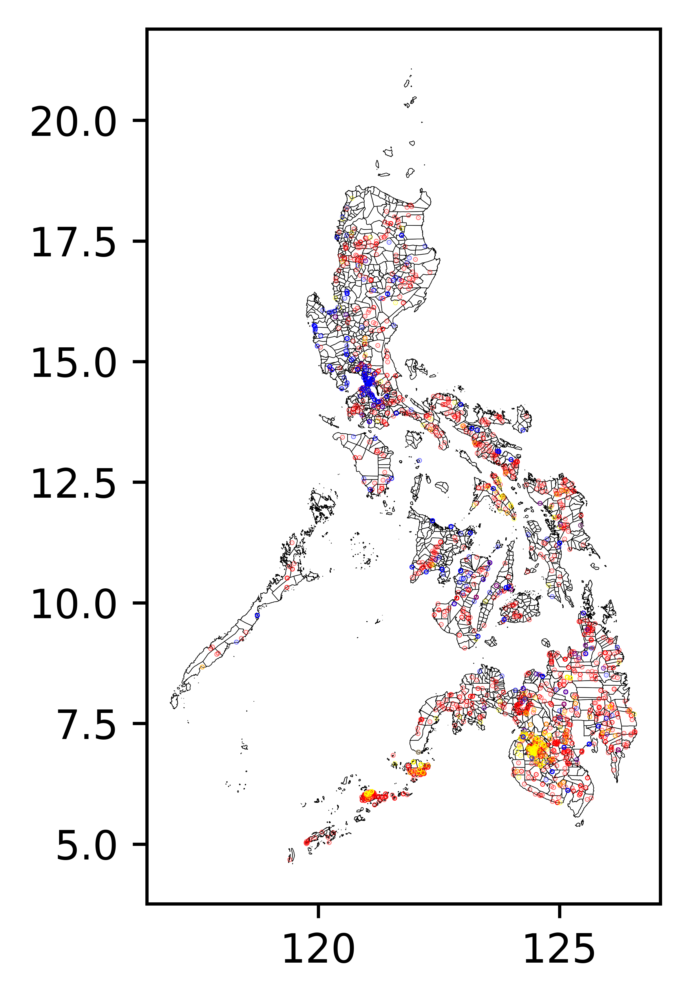

In [33]:
plot_conflicts([2016,2017,2018,2019,2020])

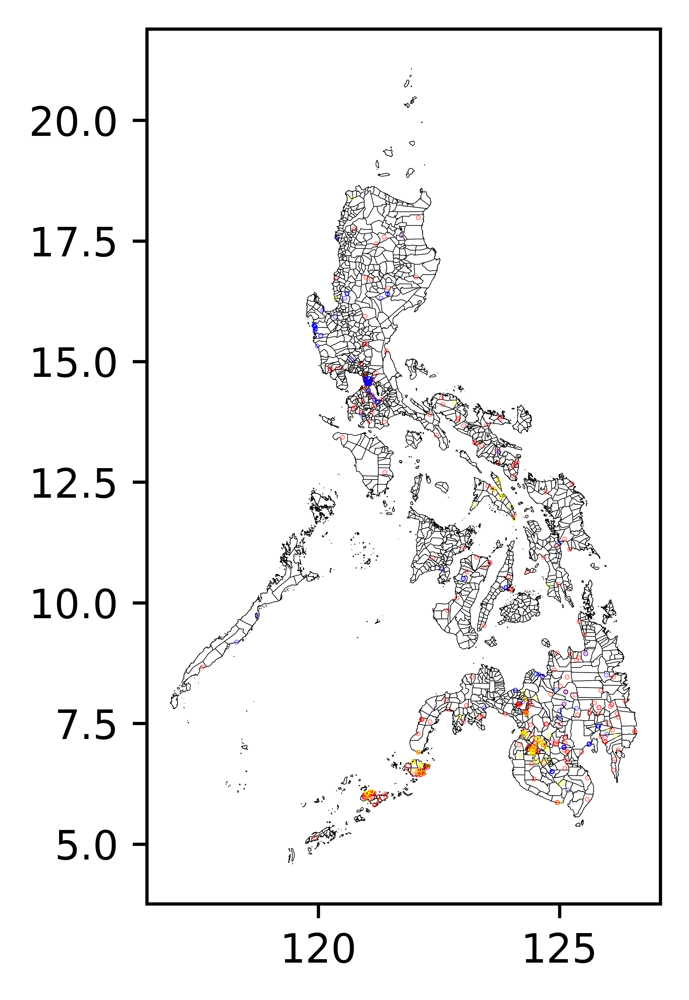

In [34]:
plot_conflicts([2016])

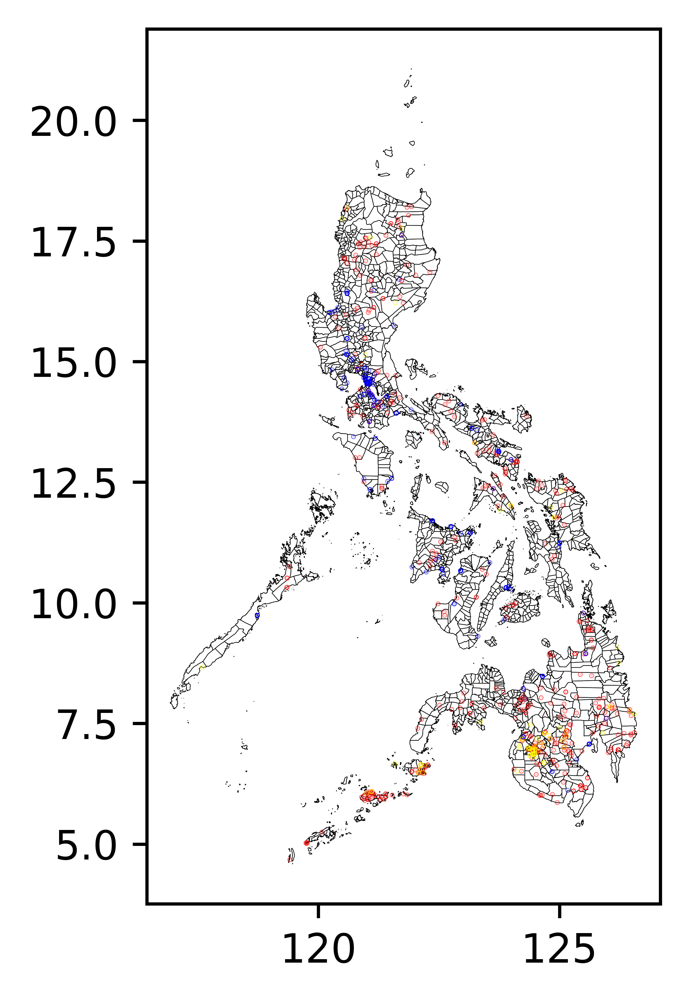

In [35]:
plot_conflicts([2017])

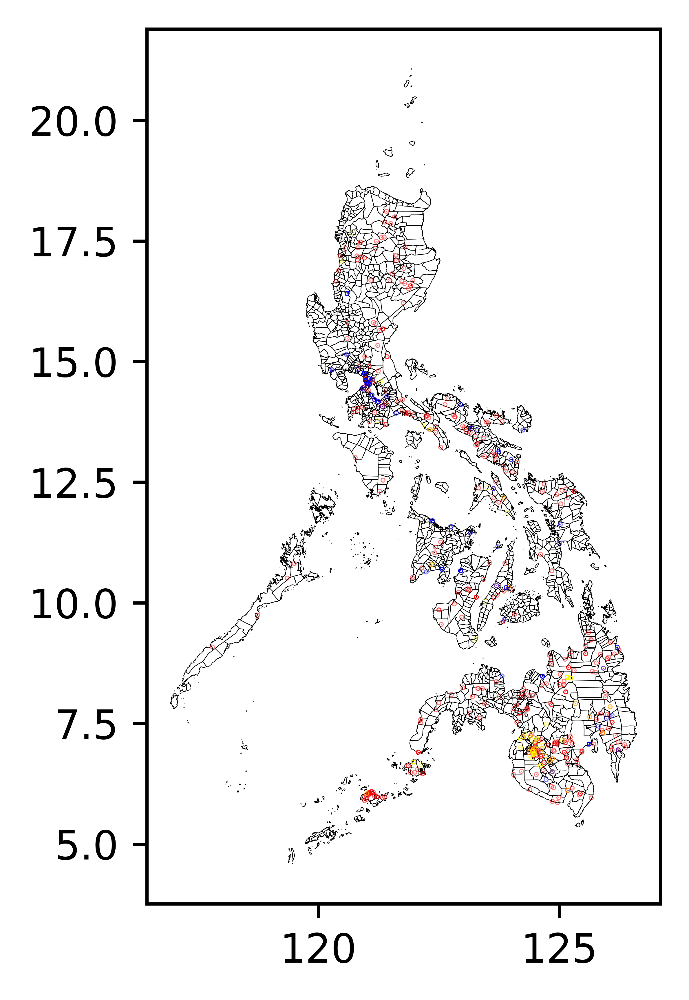

In [36]:
plot_conflicts([2018])

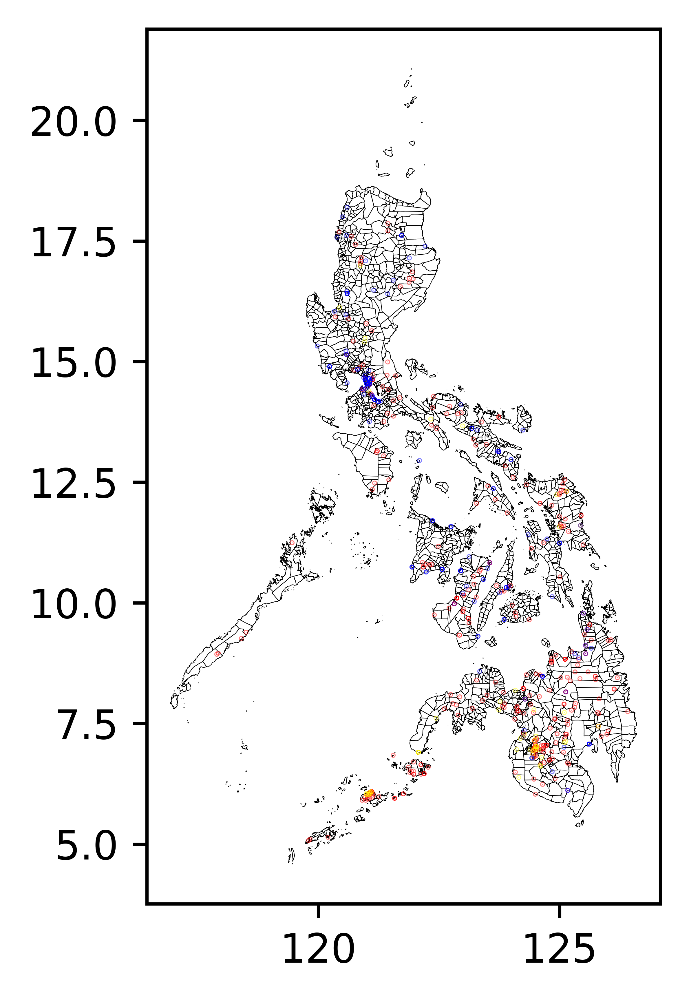

In [37]:
plot_conflicts([2019])

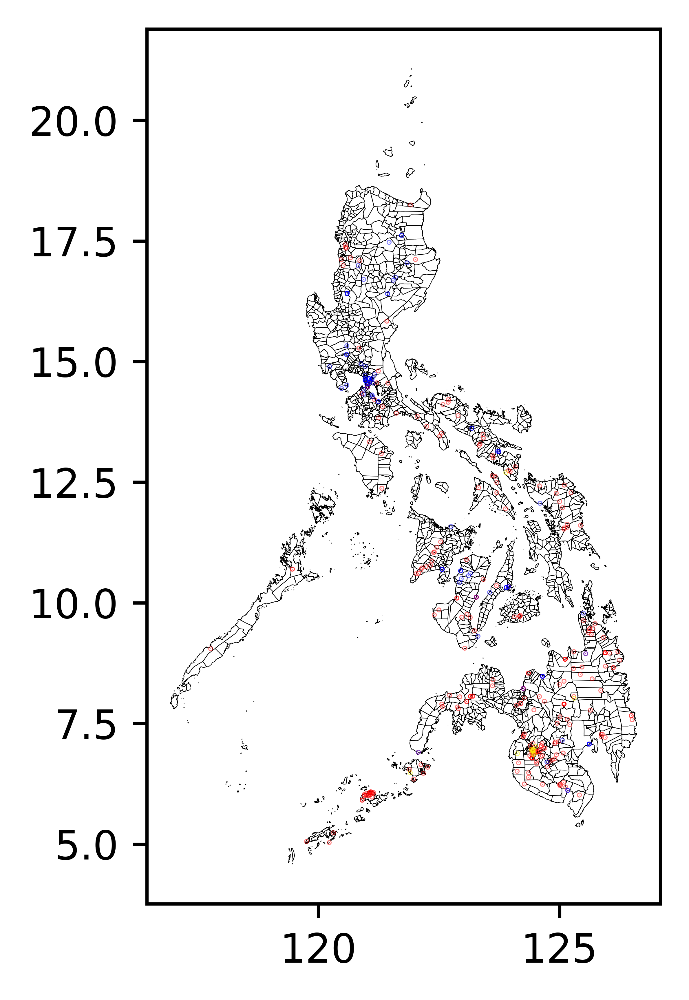

In [38]:
plot_conflicts([2020])

#### Insights
* A dataset of over 2,000 battles from 2016 to 2020 identified over 43 groups
* It is clear that <b>most conflict occurs between the PNP, MILF, BIFF, NPA, and Private armies</b>

In [109]:
df_act = df.loc[df.event_type.isin(['Battles','Explosions/Remote violence'])].groupby(['actor1','date']).count().reset_index()


In [111]:
len(set(list(df.loc[df.event_type.isin(['Battles','Explosions/Remote violence'])]['actor1'])+list(df.loc[df.event_type.isin(['Battles','Explosions/Remote violence'])]['actor2'])))




80

In [110]:
df.loc[df.event_type.isin(['Battles','Explosions/Remote violence'])].\
groupby(['actor1','actor2']).\
count().reset_index()[['actor1','actor2','iso']].\
sort_values(by='iso',ascending=False)[:50].\
to_csv('processed_actor_chart.csv')

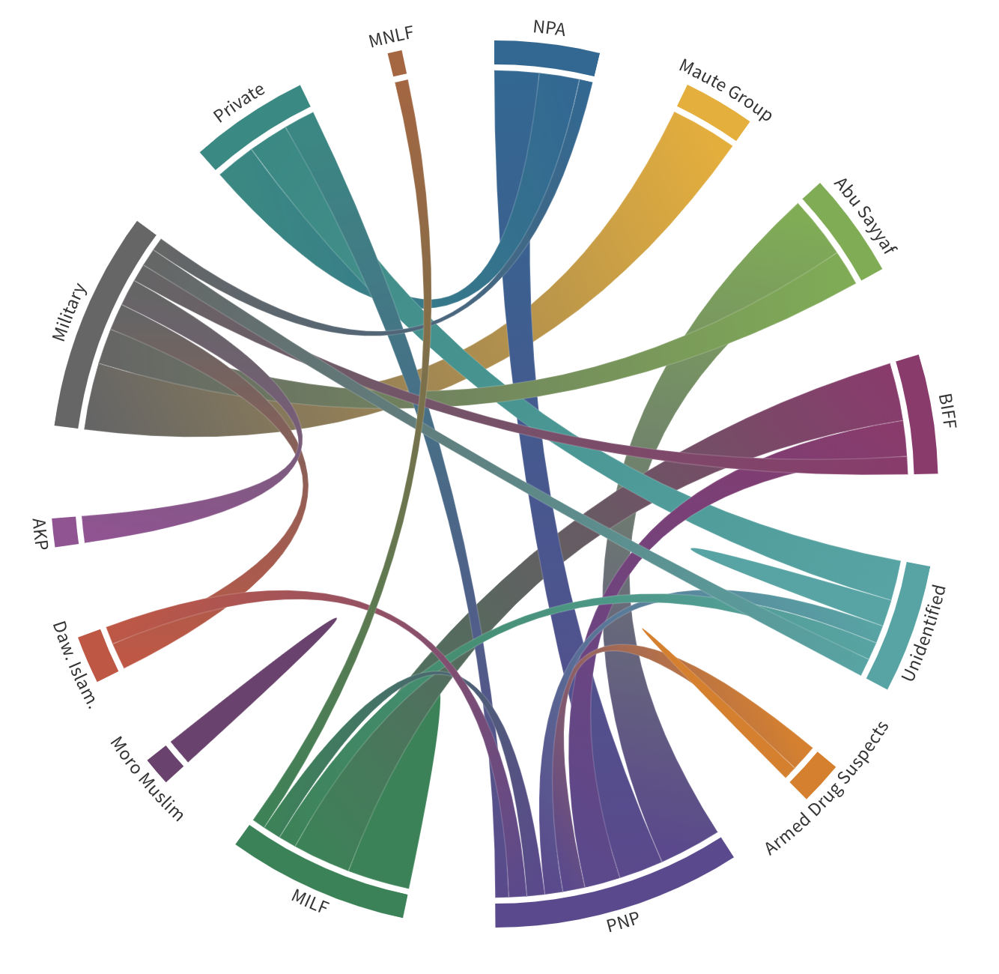

### Bangsamoro Organic Law & Anti-Terror Bill

In [42]:
df['fatalities'] = df.fatalities.astype(int)
df_agg = df.groupby(['date','admin2','event_type']).agg({'fatalities':['sum','count']}).reset_index()
df_agg.columns = ['date','prov','type','fatalities','events']
df_agg

,date,prov,type,fatalities,events
0,2016-01-01,Agusan del Norte,Battles,1,1
1,2016-01-01,Basilan,Battles,1,1
2,2016-01-01,Basilan,Explosions/Remote violence,0,3
3,2016-01-01,Basilan,Strategic developments,0,2
4,2016-01-01,Basilan,Violence against civilians,1,1
...,...,...,...,...,...
3911,2020-07-01,Zamboanga del Norte,Battles,2,3
3912,2020-07-01,Zamboanga del Norte,Strategic developments,0,1
3913,2020-07-01,Zamboanga del Norte,Violence against civilians,1,1
3914,2020-07-01,Zamboanga del Sur,Violence against civilians,0,1


#### Insight
* From the graph, it <b>doesn't seem like the frequency of battles is less</b> after the law passed 
* Using KNN (we used this because Granger doesn't give sensible results), <b>Sulu and Cotabato are the closest to Maguindanao</b>, so this will be used as control
* The passing of the Bangsamoro Law <b>reduced violence by 0.8 battles a month</b>, which is a relatively small reduction 

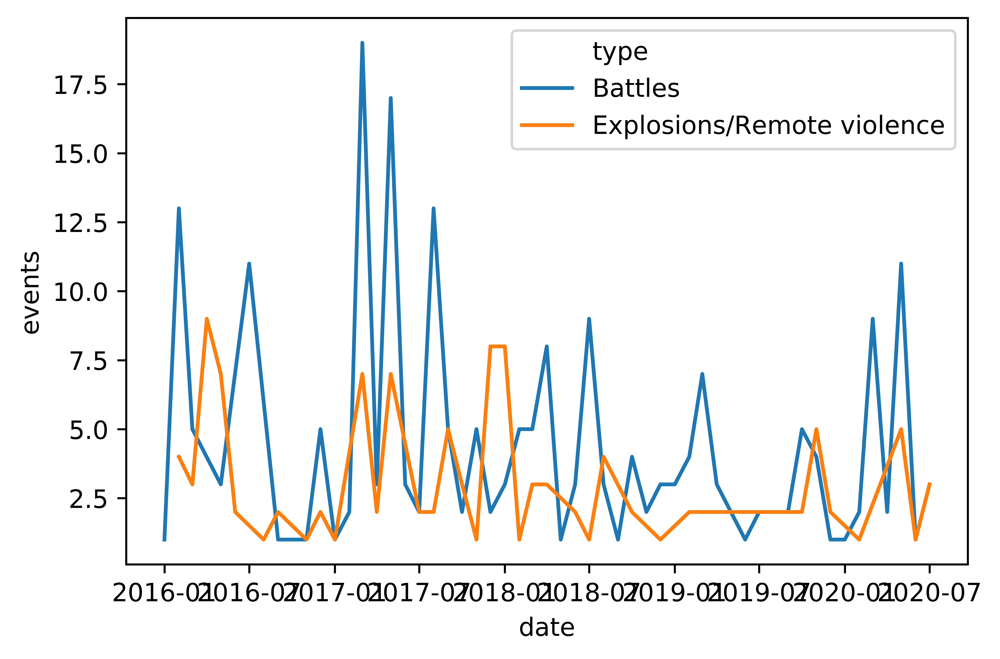

In [43]:
sns.lineplot(df_agg.loc[(df_agg.prov=='Maguindanao')&(df_agg.type.isin(['Battles','Explosions/Remote violence']))]['date'],
             df_agg.loc[(df_agg.prov=='Maguindanao')&(df_agg.type.isin(['Battles','Explosions/Remote violence']))]['events'],
             hue=df_agg.loc[(df_agg.prov=='Maguindanao')&(df_agg.type.isin(['Battles','Explosions/Remote violence']))]['type'])


In [66]:
pd.pivot_table(df_agg.loc[(df_agg.prov=='Maguindanao')&\
                          (df_agg.type.isin(['Battles','Explosions/Remote violence']))]\
               [['date','events','type']],
              values='events',
              columns='type',
              index='date').to_csv('fig_E.csv')

In [44]:
# Put dates as columns and provinces as rows
df_piv = pd.pivot(df_agg.loc[df_agg.type=='Battles'],
         values='events',
         index='date',
         columns='prov').fillna(0)
df_piv = df_piv.T.reset_index()
df_piv

date,prov,2016-01-01 00:00:00,2016-02-01 00:00:00,2016-03-01 00:00:00,2016-04-01 00:00:00,2016-05-01 00:00:00,2016-06-01 00:00:00,2016-07-01 00:00:00,2016-08-01 00:00:00,2016-09-01 00:00:00,...,2019-10-01 00:00:00,2019-11-01 00:00:00,2019-12-01 00:00:00,2020-01-01 00:00:00,2020-02-01 00:00:00,2020-03-01 00:00:00,2020-04-01 00:00:00,2020-05-01 00:00:00,2020-06-01 00:00:00,2020-07-01 00:00:00
0,Abra,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0
1,Agusan del Norte,1.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,...,0.0,4.0,1.0,0.0,2.0,0.0,2.0,0.0,0.0,0.0
2,Agusan del Sur,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,...,0.0,0.0,1.0,1.0,0.0,1.0,2.0,2.0,0.0,0.0
3,Albay,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,2.0,0.0,1.0,0.0
4,Antique,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
68,Tawi-Tawi,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,1.0,0.0,1.0,0.0,0.0,0.0,1.0,1.0,0.0
69,Zambales,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
70,Zamboanga Sibugay,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,1.0,0.0
71,Zamboanga del Norte,1.0,0.0,0.0,1.0,1.0,0.0,0.0,3.0,0.0,...,1.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,2.0,3.0


#### Bangsamoro Organic Law

In [45]:
# Nearest neighbors for Maguindanao
nbrs = NearestNeighbors(n_neighbors=10, algorithm='ball_tree').fit(df_piv.iloc[:,1:31])
distances, indices = nbrs.kneighbors(df_piv.iloc[:,1:31])
df_piv['prov'][indices[39]]

39         Maguindanao
64                Sulu
21            Cotabato
7              Basilan
26       Davao del Sur
1     Agusan del Norte
12            Bukidnon
55              Quezon
35              Laguna
41        Metro Manila
Name: prov, dtype: object

In [46]:
df_piv.loc[df_piv.prov.isin(['Maguindanao', 'Sulu', 'Cotabato']),
           df_piv.columns[1]:df_piv.columns[30]].apply(np.mean,axis=1)

21    2.700000
39    4.666667
64    3.400000
dtype: float64

In [47]:
df_piv.loc[df_piv.prov.isin(['Maguindanao', 'Sulu', 'Cotabato']),
           df_piv.columns[30]:].apply(np.mean,axis=1)

21    1.846154
39    3.384615
64    2.923077
dtype: float64

In [48]:
# Using Sulu as the counterfactual
(3.384615-4.666667)-(2.923077-3.400000)

-0.8051290000000004

#### Anti-Terror Bill

In [49]:
df_piv.loc[df_piv.prov.isin(['Maguindanao', 'Sulu', 'Cotabato']),
           df_piv.columns[49]:df_piv.columns[54]].apply(np.mean,axis=1)


21    2.000000
39    4.333333
64    3.000000
dtype: float64

In [50]:
df_piv.loc[df_piv.prov.isin(['Maguindanao', 'Sulu', 'Cotabato']),
           df_piv.columns[54]:df_piv.columns[55]].apply(np.mean,axis=1)


21    1.0
39    2.0
64    4.5
dtype: float64

In [51]:
(2.0-4.33)-(3-4.5)

-0.8300000000000001

#### Maguindanao Average

In [52]:
np.mean(df_piv.loc[df_piv.prov=='Maguindanao'],axis=1)

39    4.090909
dtype: float64

#### Insight
* Military and police forces are most engaged in battle
* NPA is most frequent rebel group that is in conflict, followed by Islamic separatist groups

In [144]:
df_act_sub = df.loc[df.event_type.isin(['Battles','Explosions/Remote violence','Violence against civilians'])][['date','actor1','fatalities']].\
append(df.loc[df.event_type.isin(['Battles','Explosions/Remote violence','Violence against civilians'])][['date','actor2','fatalities']].\
       rename(columns={'actor2':'actor1'})).\
groupby(['actor1','date']).\
agg({'fatalities':['size','sum']}).reset_index()

df_act_sub.columns = ['actor1','date','count','sum']
df_act_sub


,actor1,date,count,sum
0,AKP: Ansar al-Khilafah in the Philippines,2016-04-01,1,2
1,AKP: Ansar al-Khilafah in the Philippines,2016-08-01,1,3
2,AKP: Ansar al-Khilafah in the Philippines,2017-01-01,2,3
3,AKP: Ansar al-Khilafah in the Philippines,2017-05-01,1,1
4,AKP: Ansar al-Khilafah in the Philippines,2018-09-01,1,0
...,...,...,...,...
909,Unidentified Communal Militia (Philippines),2016-09-01,2,2
910,Unidentified Communal Militia (Philippines),2016-10-01,5,5
911,Unidentified Communal Militia (Philippines),2016-11-01,2,5
912,Unidentified Communal Militia (Philippines),2017-05-01,1,2


In [145]:
pd.pivot_table(df_act_sub[['date','sum','actor1']],
              values='sum',
              columns='actor1',
              index='date').T.to_csv('fig_F_cas.csv')

In [146]:
pd.pivot_table(df_act_sub[['date','count','actor1']],
              values='count',
              columns='actor1',
              index='date').to_csv('fig_F_count.csv')

#### Insight
* 8,712 cases of civilian deaths, followed by PFP and Military


In [147]:
df_act_sub_casualty = df_act_sub.groupby(['actor1']).sum().reset_index()


In [149]:
df_act_sub_casualty.sort_values(by='sum',ascending=False)

,actor1,count,sum
21,Civilians (Philippines),6548,8172
78,Police Forces of the Philippines (2016-),3241,4395
52,Military Forces of the Philippines (2016-),1533,3214
5,Anti-Drug Vigilantes (Philippines),2058,2518
46,Maute Group,225,1451
...,...,...,...
19,Civilians (Indonesia),5,0
41,Madidis Clan Militia (Philippines),2,0
32,HNP: Hugpong Ng Pagbabago,1,0
29,Gaang Communal Militia (Philippines),1,0


In [154]:
sum(df_act_sub_casualty.loc[df_act_sub_casualty.actor1.str.contains('Military')]['sum'])

3712

In [155]:
sum(df_act_sub_casualty.loc[df_act_sub_casualty.actor1.str.contains('Police Forces')]['sum'])

4702

In [156]:
sum(df_act_sub_casualty.loc[df_act_sub_casualty.actor1.str.contains('Civilian')]['sum'])

8201

In [ ]:
df_act_sub_casualty['ave'] = df_act_sub_casualty['sum']/df_act_sub_casualty['count']
df_act_sub_casualty.sort_values(by='ave',ascending=False)

#### Deprecated

In [53]:
top_10 = list(df_act.groupby('actor1').\
              agg({'iso':'sum'}).\
              sort_values(by='iso',ascending=False).\
              reset_index().\
              loc[:20]['actor1'])


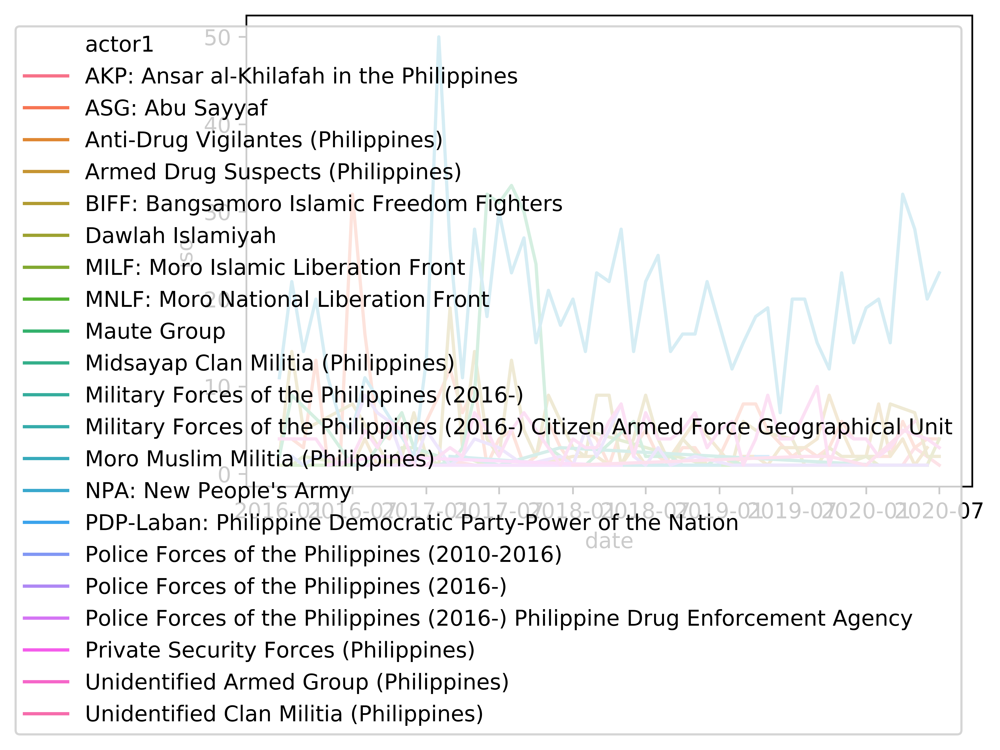

In [54]:
sns.lineplot(df_act[df_act.actor1.isin(top_10)]['date'],
             df_act[df_act.actor1.isin(top_10)]['iso'],
             hue=df_act[df_act.actor1.isin(top_10)]['actor1'])

In [55]:
pd.pivot_table(df_act[df_act.actor1.isin(top_10)][['date','iso','actor1']],
              values='iso',
              columns='actor1',
              index='date').to_csv('fig_F.csv')

#### Insight
How many new ones come up?

In [56]:
for yr in range(2016,2021):
    temp = df[df.year==yr]
    print(f"Year {yr}: {len(set(temp.actor1))}")

Year 2016: 53
Year 2017: 41
Year 2018: 39
Year 2019: 45
Year 2020: 23


In [62]:
set(df[df.year==2019]['actor1']).difference(set(df[df.year==2018]['actor1']))

{'Balingasag Communal Militia (Philippines)',
 'Baraontong Clan Militia (Philippines)',
 'Dawlah Islamiyah',
 'Islamic State (Philippines)',
 'Islamist Militia (Philippines)',
 'Mamasapano Clan Militia (Philippines)',
 'Midsayap Clan Militia (Philippines)',
 'Nacionalista Party',
 'PDP-Laban: Philippine Democratic Party-Power of the Nation',
 'PPP: Partidong Pagbabago ng Palawan',
 'Police Forces of the Philippines (2010-2016) Philippine Drug Enforcement Agency',
 'Police Forces of the Philippines (2016-) Anti-Illegal Drugs Special Operations Task Force',
 'Police Forces of the Philippines (2016-) Barangay Peace and Security Officer',
 'Police Forces of the Philippines (2016-) Prison Guards',
 'Police Forces of the Philippines (2016-) Regional Police Drug Enforcement Unit',
 'Police Forces of the Philippines (2016-) Regional Public Safety Battalion',
 'Police Forces of the Philippines (2016-) Special Action Force',
 'RPA-ABB: Revolutionary Proletarian Army-Alex Boncayao Brigade',
 'San

### Poverty

In [87]:
# pov = pd.read_csv('Poverty_City_Mun.csv')

# Change names for poverty and subset
# pov.loc[pov.Province=='Tawi-tawi','Province'] = 'Tawi-Tawi'
# pov.loc[pov.Province.isin(['1st district','2nd district','3rd district','4th district']),
#         'Province'] = 'Metropolitan Manila'
# pov.loc[pov.Province=='Samar (Western)','Province'] = 'Samar'
# pov.loc[pov.Province=='Cotabato City','Province'] = 'Maguindanao'
# pov.loc[pov.Province=='Isabela City','Province'] = 'Basilan'

# pov = pov[['PCODE','Province','Municipality_City','Pov_2012','Pov_2009','Pov_2006']]
# pov.columns = ['psgc','Prov','Mun','Pov_2012','Pov_2009','Pov_2006']

# Change names for shapefiles and subset
# mun.loc[mun.NAME_1=='Shariff Kabunsuan','NAME_1'] = 'Maguindanao'
# mun = mun[['NAME_1','NAME_2','geometry']]
# mun.columns = ['Prov','Mun','geometry']

# Aggregate to facilitate matching
# mun.loc[:,'join'] = [a+', '+b for (a,b) in zip(mun['Prov'],mun['Mun'])]
# pov.loc[:,'join'] = [a+', '+b for (a,b) in zip(pov['Prov'],pov['Mun'])]

# Fuzzymatching (a lifesaver)
# temp = [process.extractOne(mun['join'][i], pov['join'])[0] for i in range(len(mun))]
# mun['match'] = temp

# pov = pd.merge(mun,
#              pov[['join','Pov_2012','Pov_2009','Pov_2006']],
#              left_on='match',
#              right_on='join').drop(['join_x','join_y','match'],
#                                    axis=1)

In [73]:
pov = pd.read_csv('Processed_Poverty_GPD.csv')
pov['geometry'] = [shapely.wkt.loads(i) for i in pov['geometry']]
pov = gpd.GeoDataFrame(pov,geometry=pov['geometry'],crs='EPSG:4326')

#### Insight
* Areas with <b>high poverty are often sites of major conflict</b>
* Notice entire stretches of red areas that have many battles/explosions

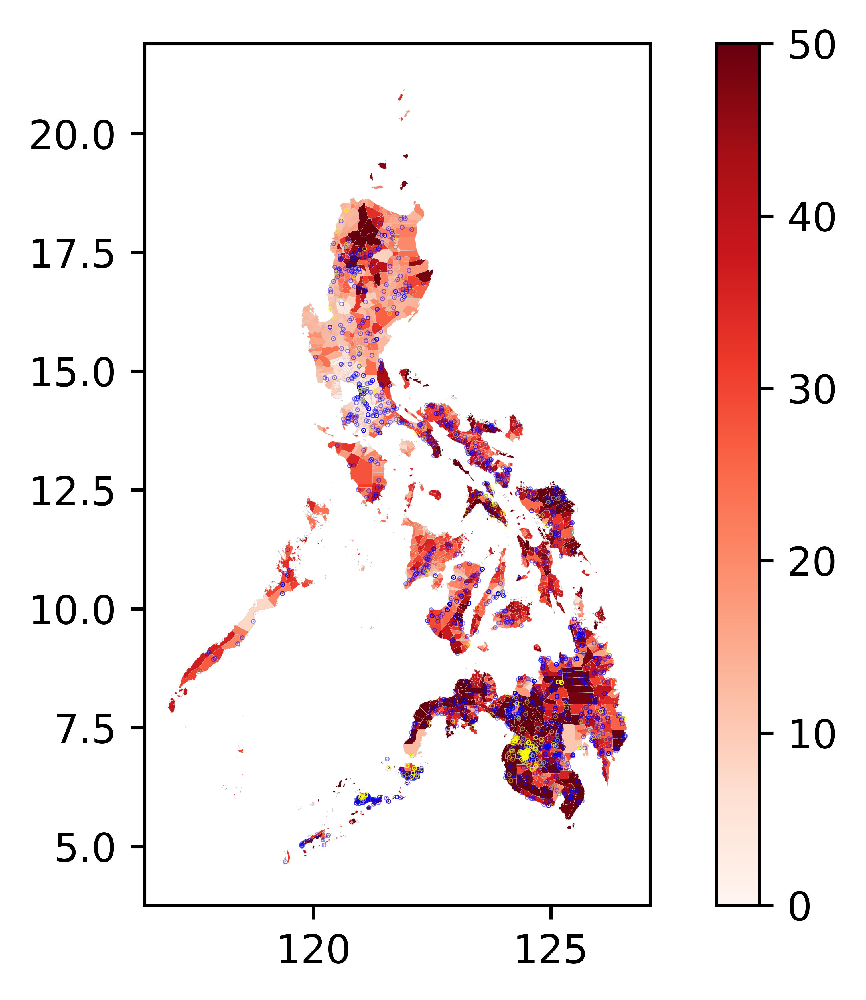

In [89]:
import matplotlib
plt.rcParams['figure.dpi'] = 1000
norm = matplotlib.colors.Normalize(0,50,clip=True)
ax = pov.plot(column='Pov_2012', cmap='Reds', 
         linewidth=0.05, edgecolor='0.8', norm=norm, legend=True)
df.loc[df.event_type.isin(['Battles'])].plot(ax=ax, alpha=0.5, markersize=0.05, color='blue')
df.loc[df.event_type.isin(['Explosions/Remote violence'])].plot(ax=ax, alpha=0.5, markersize=0.05, color='yellow')


#### Insight
* <b>Positive weak linear (0.254) relationship between explosions in a month and poverty incidence</b>, likely because there are also poor areas which do not experience violence

In [74]:
# Locate the conflicts to their municipalities
pov.crs = df.crs
df_join = gpd.sjoin(df,pov,how='left',op='within')

df_join = df_join[['event_type','fatalities','Prov','Mun']].\
groupby(['Prov','Mun','event_type']).agg({'fatalities':['count','sum']}).reset_index()


df_join = pd.merge(df_join,pov,on=['Prov','Mun'])
df_join.columns = ['Prov','Mun','P','M','Type','Count','Fatalities','unnamed','geometry','Pov_2012','Pov_2009','Pov_2006']
df_join = df_join[['Prov', 'Mun', 'Type', 'Count', 'Fatalities', 'geometry',
       'Pov_2012', 'Pov_2009', 'Pov_2006']]


/Users/lorenzoflores/anaconda3/lib/python3.7/site-packages/pandas/core/reshape/merge.py:618: UserWarning: merging between different levels can give an unintended result (2 levels on the left, 1 on the right)
  warnings.warn(msg, UserWarning)


In [91]:
np.corrcoef(df_join[df_join.Type=='Explosions/Remote violence']['Pov_2012'],
                df_join[df_join.Type=='Explosions/Remote violence']['Count'])

array([[1.        , 0.25414322],
       [0.25414322, 1.        ]])

[(0, 50)]

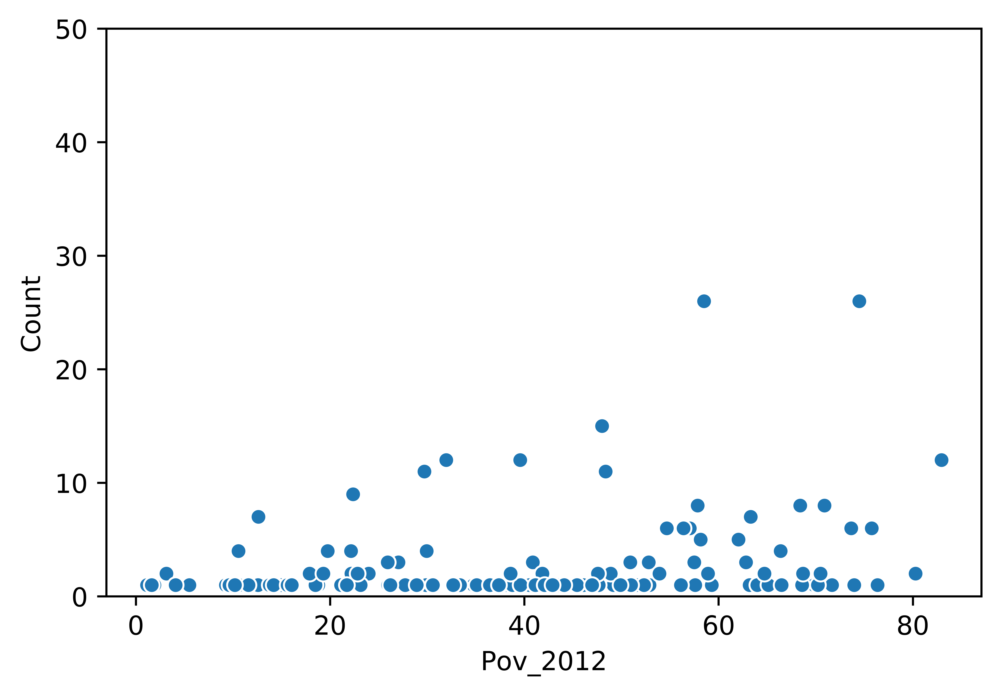

In [92]:
a_plot = sns.scatterplot(df_join[df_join.Type=='Explosions/Remote violence']['Pov_2012'],
                df_join[df_join.Type=='Explosions/Remote violence']['Count'])
a_plot.set(ylim=(0, 50))

### Predictive Model for Battles

In [93]:
os.listdir()

['EDA.ipynb',
 'Violence_Terrorism_Count.csv',
 'Violence_Prison.csv',
 'Finance_IRA_Mun.csv',
 'Violence_Terrorism.csv',
 '.DS_Store',
 'Violence_Homicide_2.csv',
 'Processed_Poverty_GPD.csv',
 'Water_Type.xlsx',
 'Finance_IRA_Mun.numbers',
 'processed_actor_chart.csv',
 'Violence_Fear Walking.xlsx',
 'Violence_Homicide.xlsx',
 'Violence_Trafficking.csv',
 'Health_RHU.csv',
 'Finance_IRA_Mun.xls',
 'Finance_Business',
 'Population_Urban.csv',
 '.ipynb_checkpoints',
 'Poverty_City_Mun.csv',
 'Violence_Conflict_Linelist.csv',
 'Reference.ipynb',
 'Population_Province.xls']

### 1. IRA Dependency

In [94]:
def clean_num(x):
    try:
        return float(x.replace('%',''))
    except:
        return x

In [96]:
ira = pd.read_csv('Finance_IRA_Mun.csv')
ira = ira.applymap(clean_num)

df_join['join'] = [a+', '+b for (a,b) in zip(df_join.Prov,df_join.Mun)]
ira['join'] = [a.title()+', '+b.title() for (a,b) in zip(ira.Province,ira['LGU NAME'])]
pov['join'] = [a+', '+b for (a,b) in zip(pov.Prov,pov.Mun)]

df_model = pd.merge(pov, 
         df_join.loc[df_join.Type.isin(['Battles','Explosions/Remote violence'])]\
         [['Type','Count','Fatalities','join']],
         on='join',
         how='left')

temp = [process.extractOne(x, ira['join'])[0] for x in df_model['join']]
df_model['join_ira'] = temp

df_model = pd.merge(df_model, ira.iloc[:,3:], left_on='join_ira', right_on='join', how='left')

### 2. Economic Growth

In [109]:
df_model['Pov_Change'] = df_model['Pov_2012']-df_model['Pov_2009']

### 3. Political Stability

In [120]:
df_temp = pd.pivot_table(df_join.loc[df_join.Type.isin(['Riots','Protests'])][['Type','Count','Fatalities','join']],
               index='join',
               columns='Type',
              values=['Count','Fatalities']).reset_index()
df_temp.columns = ['join','count_protest','count_riot','fatal_protest','fatal_riot']

df_temp = df_temp.fillna(0)

df_model = pd.merge(df_model, df_temp, on='join', how='outer')

### Prediction

In [134]:
# df_model['Type'] = df_model['Type'].fillna('Battles')
# df_model.loc[:,['Count','Fatalities','count_protest',
#                 'count_riot','fatal_protest','fatal_riot']] = df_model.loc[:,['Count','Fatalities','count_protest',
#                 'count_riot','fatal_protest','fatal_riot']].fillna(0)
# df_model_sub = df_model.loc[df_model.Type=='Battles']
# df_model_sub = df_model_sub.drop(['Unnamed: 0','join_x','join_y','geometry','Type'],axis=1)
# df_model_sub.to_csv('processed_prediction_df.csv')

In [179]:
from sklearn.datasets import make_classification
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import RepeatedStratifiedKFold
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.model_selection import RandomizedSearchCV
from sklearn.model_selection import KFold, cross_validate

import xgboost as xgb
from xgboost import XGBClassifier

import lightgbm as lgb

import imblearn 
from imblearn.over_sampling import SMOTE, ADASYN


In [ ]:
df_model_sub['battle'] = 1*(df_model_sub['Count']>0)

for col in ['2009', '2010', '2011', '2012', '2013', '2014', '2015', '2016', '2017', '2018']:
    df_model_sub[col] = df_model_sub[col].fillna(np.nanmedian(df_model_sub[col]))

In [172]:
# define the model
model = GradientBoostingClassifier()

# define parameter space
distributions = dict(learning_rate = list(np.linspace(0.05,0.3,6)), 
                     n_estimators = list(range(1,11)), 
                     min_samples_split = list(range(2,8)))

# define cross validation
cv = KFold(shuffle = True, n_splits = 5)

# instantiate
clf = RandomizedSearchCV(model, distributions, cv=cv)


In [187]:
# define the model
search1_xgb = xgb.XGBClassifier(objective = 'binary:logistic',
                                eval_metric = 'error')

# define parameter space
param_dist = {'eta': list(np.linspace(0.05,0.3,6)), 
              'gamma': list(np.linspace(0,0.5,6))
             }

# define cross validation
cv = KFold(shuffle = True, n_splits = 5)

# instantiate
clf_xgb = RandomizedSearchCV(search1_xgb, param_dist, cv = cv)


In [188]:
# define the model
search1_lgb = lgb.LGBMClassifier(objective = 'binary',
                                eval_metric = 'error')

# define parameter space
param_dist = {'eta': list(np.linspace(0.05,0.3,6)), 
              'gamma': list(np.linspace(0,0.5,6))
             }

# define cross validation
cv = KFold(shuffle = True, n_splits = 5)

# instantiate
clf_lgb = RandomizedSearchCV(search1_lgb, param_dist, cv = cv)


In [189]:
# balance the dataset
X, y = SMOTE().fit_resample(df_model_sub.drop(['Prov','Mun','Count','Fatalities','battle','join_ira'],axis=1), 
                              df_model_sub['battle'])


In [198]:
X = pd.DataFrame(X)
X.columns = ['Pov_2012', 'Pov_2009', 'Pov_2006', 'Pov_Change', 'count_protest',
       'count_riot', 'fatal_protest', 'fatal_riot', '2009', '2010', '2011',
       '2012', '2013', '2014', '2015', '2016', '2017', '2018']

In [190]:
print('Medium Risk: 10 cases and above')
# fit
search1 = clf.fit(X, y)
print('Gradient Boost: '+str(search1.best_score_))

# fit XGBoost
search1_xgb = clf_xgb.fit(X, y)
print('XGBoost: '+str(search1_xgb.best_score_))

# fit Light GBM
search1_lgb = clf_lgb.fit(X, y)
print('LGBM: '+str(search1_lgb.best_score_))

Medium Risk: 10 cases and above
Gradient Boost: 0.6486896674554105
XGBoost: 0.6804429687301223
LGBM: 0.6905236241508282


In [192]:
import shap
from shap import TreeExplainer, summary_plot, dependence_plot

def plotImp(X, y, model):
    feat = pd.DataFrame({'Feature':list(X.columns),
                          'Importance':model.best_estimator_.feature_importances_})
    feat = feat.sort_values(by='Importance',ascending=False)

    # Plot feature importances
    sns.set_style("whitegrid")
    plt.figure(figsize=(10,3))
    sns.barplot(x='Importance', 
                y='Feature', 
                data=feat,
                color='blue').set_title('Feature Importances')
    plt.show()
    
    print('\n')
    
    # SHAP values
    explainer = TreeExplainer(model.best_estimator_,
                             feature_perturbation = "tree_path_dependent")
    shapval = explainer.shap_values(X, y)
    summary_plot(shapval, X, X.columns)

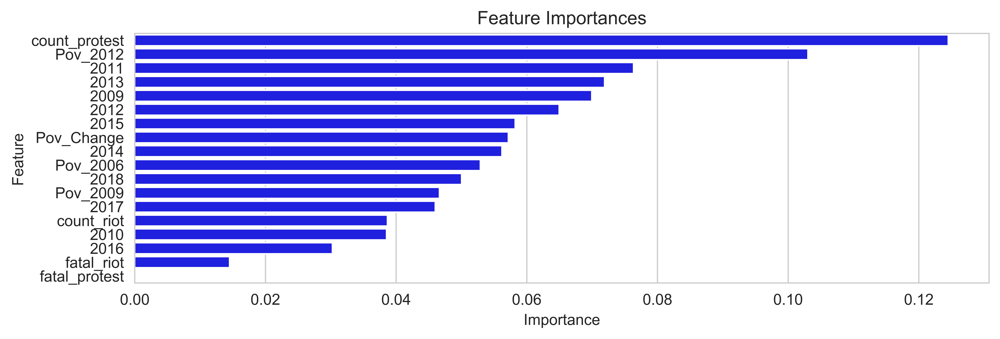

Setting feature_perturbation = "tree_path_dependent" because no background data was given.


In [199]:
plotImp(X, y, search1_xgb)

In [227]:
from scipy.stats import ranksums
ranksums(df_model_sub.loc[df_model_sub.battle==1]['Pov_2012'], 
         df_model_sub.loc[df_model_sub.battle==0]['Pov_2012'])

RanksumsResult(statistic=7.016805100111522, pvalue=2.2699890288702823e-12)

In [228]:
ranksums(df_model_sub.loc[df_model_sub.battle==1]['count_protest'], 
         df_model_sub.loc[df_model_sub.battle==0]['count_protest'])

RanksumsResult(statistic=2.9522193991904087, pvalue=0.00315498673161772)

In [229]:
ranksums(df_model_sub.loc[df_model_sub.battle==1]['count_riot'], 
         df_model_sub.loc[df_model_sub.battle==0]['count_riot'])

RanksumsResult(statistic=0.9222233573760683, pvalue=0.35641208201600405)